In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import keras
from warnings import filterwarnings
filterwarnings('ignore')
import os
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
from nltk import word_tokenize
import time
import string
import re

# File Load

In [2]:
file="Reviews.csv"
data= pd.read_csv(file)
print(data.shape)

(334119, 31)


In [3]:
data.describe()

,Unnamed: 0,ï»¿,ratings_overall,labels,likeCount,latitude,longitude,primary_cuisine_id,review_number,restaurant_overall_rating
count,334119.000000,334119.000000,334119.000000,334119.000000,334119.000000,334119.000000,334119.000000,334119.000000,334119.000000,334119.000000
mean,167059.000000,168411.559947,2.817562,1.916958,0.241884,23.668077,90.623229,127.527136,4014.909981,3.841418
std,96451.991633,96817.799309,1.684886,0.935649,0.629411,0.528833,0.528335,54.243513,5812.797803,0.445709
min,0.000000,0.000000,1.000000,1.000000,-2.000000,22.269991,90.210323,0.000000,0.000000,0.000000
25%,83529.500000,84763.500000,1.000000,1.000000,0.000000,23.741879,90.371986,85.000000,488.000000,3.600000
50%,167059.000000,168499.000000,3.000000,2.000000,0.000000,23.773776,90.405709,86.000000,1584.000000,3.900000
75%,250588.500000,252235.500000,5.000000,3.000000,0.000000,23.810406,90.425728,193.000000,4697.000000,4.100000
max,334118.000000,335947.000000,5.000000,3.000000,51.000000,24.919806,91.910593,249.000000,32993.000000,5.000000


# <h2> Max and Min Sentance Length</h2>

In [4]:
print('Number of Duplicates:', len(data[data.duplicated()]))
# data = data.drop_duplicates(keep="last")

Number of Duplicates: 0


In [5]:
print(len(max(data['text'],key=len)))
print(len(min(data['text'],key=len)))

366
3


In [6]:
label = data[(data['labels'] == 1) | (data['labels'] == 3)]
label.shape

(294804, 31)

In [7]:
y = label['labels']
x = label['text'].reset_index()

# **NLP Processing** <a id="3"></a>

In [8]:
import nltk
stemmer = nltk.SnowballStemmer("english")
from nltk.corpus import stopwords
import string
stopword=set(stopwords.words('english'))
t = time.time()

def leadMyWord(text):
    text = text.lower()
    
    text = re.sub(r"don't", "do not", text)
    text = re.sub(r"don t", "do not", text)
    text = re.sub(r"didn't", "did not", text)
    text = re.sub(r"didn t", "did not", text)
    text = re.sub(r"won't", "will not", text)
    text = re.sub(r"won t", "will not", text)
    text = re.sub(r"isn't", "is not", text)
    text = re.sub(r"isn t", "is not", text)
    text = re.sub(r"aren't", "are not", text)
    text = re.sub(r"aren t", "are not", text)
    text = re.sub(r"wasn't", "was not", text)
    text = re.sub(r"wasn t", "was not", text)
    text = re.sub(r"weren't", "were not", text)
    text = re.sub(r"weren t", "were not", text)
    text = re.sub(r"haven't", "have not", text)
    text = re.sub(r"haven t", "have not", text)
    text = re.sub(r"hadn't", "had not", text)
    text = re.sub(r"hadn t", "had not", text)
    text = re.sub(r"couldn't", "could not", text)
    text = re.sub(r"couldn t", "could not", text)
    text = re.sub(r"shouldn't", "should not", text)
    text = re.sub(r"shouldn t", "should not", text)
    text = re.sub(r"can't", "can not", text)
    text = re.sub(r"can t", "can not", text)
    text = re.sub(r"it's", "it is", text)
    text = re.sub(r"it s", "it is", text)
    text = re.sub(r"kebab", "kabab", text)
    text = re.sub(r"nun", "naan", text)
    text = re.sub(r"nan", "naan", text)
    text = re.sub('[^a-zA-Z]'," ",text)
    
    text = re.sub('\[.*?\]', '', text)
    text = re.sub('<.*?>+', '', text)
    text = re.sub('[%s]' % re.escape(string.punctuation), '', text)
    text = re.sub('\n', '', text)
    text= re.sub('\s{2,}', ' ', text)
    text = re.sub('\w*\d\w*', '', text)
#     print(text)
    text = "".join(text)
#     text = [word for word in text.split() if word not in stopword]
# #     print(text,"f2nd")
#     text = " ".join(text)
#     print(text,"last")
    return text   
textList = x.text.apply(leadMyWord)
# print("Before")
# print(data["text"][2])
x['text'] = x.text.apply(leadMyWord)
# data['clean_data']=textList
textList = list(textList)
# data
# print("After")
print(textList[2])
# print("Time Passed")
# print(time.time()-t)

fresh and tasty


In [9]:
unique_words = set(textList)

# Count the number of unique words
total_unique_words = len(unique_words)

print("Total unique words:", total_unique_words)

Total unique words: 229537


In [10]:
x.loc[1:15, ['text']]

,text
1,very small in amount
2,fresh and tasty
3,everything i ordered was good
4,kalo jira vhorta balu vhorta not recommended b...
5,quantity of dal should be little more otherwis...
6,chicken was not up to the mark and lotpoti was...
7,lot of sand in kali jeers bortha
8,bad
9,very good food i chose this home kitchen rando...
10,honestly eating today s beef ribs and dal felt...


for i in range(200):
    print(textList[i])


for i in range(200):
    print(data["text"][i])

# Label encoding

In [11]:
#preparing y

from sklearn.preprocessing import LabelEncoder
from keras.utils import to_categorical

le = LabelEncoder()
labelEncode = le.fit_transform(y)
print("LabelEncode")
print(labelEncode)
categorical_y = to_categorical(labelEncode)
print("To_Categorical")
print(categorical_y)

LabelEncode
[0 0 1 ... 1 1 0]
To_Categorical
[[1. 0.]
 [1. 0.]
 [0. 1.]
 ...
 [0. 1.]
 [0. 1.]
 [1. 0.]]


# One hot encoding with padding

In [12]:
from keras.preprocessing.text import one_hot
from keras_preprocessing.sequence import pad_sequences


#preparing x for CNN
MAX_FEATURES = 48000

onehot_corpus = []
for text in textList:
#     print(text)
    onehot_corpus.append(one_hot(text,MAX_FEATURES))
    
maxTextLen = 0

# tokenlist=[]
for text in textList:
    word_token=word_tokenize(text)
#     tokenlist.append(word_token)
    print(word_token)
    print("")
    if(maxTextLen < len(word_token)):
        maxTextLen = len(word_token)
        
print("Max number of words : ",maxTextLen)
print("Max number of words : ",len(onehot_corpus))

padded_corpus=pad_sequences(onehot_corpus,maxlen=72,padding='post')


['too', 'much', 'small', 'amount']

['very', 'small', 'in', 'amount']

['fresh', 'and', 'tasty']

['everything', 'i', 'ordered', 'was', 'good']

['kalo', 'jira', 'vhorta', 'balu', 'vhorta', 'not', 'recommended', 'baki', 'shob', 'valo', 'chilo']

['quantity', 'of', 'dal', 'should', 'be', 'little', 'more', 'otherwise', 'everything', 'was', 'good', 'specially', 'beef']

['chicken', 'was', 'not', 'up', 'to', 'the', 'mark', 'and', 'lotpoti', 'was', 'full', 'of', 'potato', 'alu', 'bhorta', 'did', 'not', 'seem', 'fresh']

['lot', 'of', 'sand', 'in', 'kali', 'jeers', 'bortha']

['bad']

['very', 'good', 'food', 'i', 'chose', 'this', 'home', 'kitchen', 'randomly', 'but', 'really', 'got', 'a', 'food', 'and', 'packaging', 'please', 'always', 'maintain', 'the', 'same', 'standard', 'allah', 'bless', 'you', 'with', 'all', 'the', 'sucess']

['honestly', 'eating', 'today', 's', 'beef', 'ribs', 'and', 'dal', 'felt', 'like', 'i', 'was', 'eating', 'my', 'own', 'food', 'no', 'extra', 'colors', 'or', 'anyt

['the', 'packet', 'of', 'rupees', 'was', 'not', 'fully', 'charged', 'the', 'test', 'is', 'fine', 'sultan', 'dine', 's', 'kachi', 'is', 'filled', 'with', 'whole', 'packets', 'of', 'flowers', 'let', 's', 'give', 'importance', 'to', 'this', 'aspect']

['rice', 'onk', 'kom', 'chilo', 'and', 'packaging', 'always']

['very', 'good', 'but', 'the', 'meats', 'are', 'small', 'and', 'less', 'in', 'size']

['well']

['food', 'was', 'raw']

['so', 'yummy', 'kacchi', 'mangsho', 'piece', 'ekta', 'bariye', 'dile', 'valo', 'hoto', 'so', 'good', 'taste']

['good']

['very', 'bad', 'meat', 'quality', 'of', 'chui', 'jhal']

['good', 'but', 'should', 'get', 'a', 'better', 'piece', 'of', 'meat']

['the', 'taste', 'was', 'good']

['kacchi', 'khadok', 'mone', 'hochilo', 'je', 'single', 'kacchi', 'order', 'disi', 'khabar', 'er', 'poriman', 'onek', 'kom']

['delivery', 'boy', 'not', 'deliver', 'my', 'order']

['never', 'order', 'chuijhal', 'ekdom', 'joghonno', 'food', 'kacchi', 'unavailable', 'tai', 'order', 'd

['taste', 'was', 'okay', 'but', 'very', 'poor', 'pricing', 'compared', 'to', 'the', 'amount', 'also', 'the', 'chili', 'oil', 'price', 'i', 'dont', 'like', 'and', 'it', 'literally', 'took', 'whole', 'hour', 'to', 'prepare', 'the', 'food', 'and', 'then', 'min', 'for', 'delivery', 'disappointing']

['amazing', 'momos', 'got', 'nostalgic', 'with', 'the', 'taste', 'great', 'pricing', 'and', 'packaging', 'amazing', 'taste', 'total', 'value', 'for', 'money']

['excellent', 'steamed', 'delicacies', 'love', 'the', 'authenticity', 'of', 'the', 'baos', 'specially', 'the', 'fact', 'they', 'are', 'stuffed', 'with', 'meat']

['smallest', 'pieces', 'everr', 'and', 'taste', 'was', 'not', 'good', 'at', 'all', 'so', 'disappointed', 'omg']

['french', 'fries', 'were', 'stale', 'size', 'of', 'beef', 'sandwich', 'is', 'pretty', 'small', 'than', 'the', 'tk', 'price', 'tag']

['rhey', 'have', 'sent', 'me', 'a', 'different', 'food']

['quality', 'was', 'not', 'that', 'good', 'price', 'is', 'high', 'compared',

['in', 'a', 'word', 'remarkable', 'the', 'black', 'gum', 'is', 'so', 'hard', 'that', 'the', 'gums', 'hurt', 'when', 'chewed', 'mugdal', 'was', 'bad', 'and', 'chicken', 'is', 'not', 'available', 'in', 'some', 'places', 'the', 'quantity', 'is', 'very', 'less', 'only', 'the', 'beef', 'koliji', 'and', 'naan', 'were', 'good']

['food', 'was', 'not', 'up', 'to', 'the', 'mark', 'as', 'per', 'expectations']

['worst', 'kala', 'buna', 'ever', 'i', 'felt', 'like', 'i', 'm', 'eating', 'a', 'piece', 'of', 'concrete']

['everything', 'awesome', 'but', 'ekta', 'item', 'kom', 'chilo']

['always', 'good', 'chicken', 'chap']

['always', 'good']

['food', 'quality', 'always', 'great']

['baje', 'test', 'r', 'oder', 'dibo', 'na']

['onek', 'bala', 'kani', 'onek', 'moja']

['too', 'much', 'late']

['too', 'much', 'late']

['naan', 'bread', 'mugdal', 'parata', 'gd']

['vegetable', 'was', 'made', 'with', 'only', 'item']

['quality', 'food']

['worst', 'experience', 'faltu']

['fairly', 'well']

['grill', 'a

['awesome', 'but', 'did', 'not', 'provide', 'jhool']

['no', 'mutton', 'piece', 'only', 'bones', 'with', 'fats', 'moreover', 'the', 'food', 'was', 'cool', 'af']

['quantity', 'quality', 'maintain', 'hosse', 'na']

['quantity', 'too', 'low']

['look', 'like', 'very', 'poor', 'taste', 'and', 'quantity', 'of', 'mutton', 'and', 'rice']

['the', 'food', 'was', 'awful', 'three', 'food', 'orders', 'at', 'once', 'were', 'only', 'two', 'followed', 'by', 'potatoes', 'the', 'mutton', 'gave', 'three', 'rings', 'once', 'birani', 'had', 'hair', 'and', 'insects', 'in', 'it', 'we', 'bring', 'food', 'online', 'but', 'it', 'is', 'late', 'today']

['they', 'did', 'not', 'send', 'me', 'my', 'full', 'order', 'multiple', 'times']

['poor', 'quantity', 'i', 'will', 'never', 'ever', 'order', 'again']

['first', 'khabare', 'meat', 'chobche', 'kharap', 'chilo', 'kmn', 'ekta', 'skin', 'lege', 'chilo', 'meat', 'er', 'shathee', 'kono', 'meat', 'nai', 'ami', 'dekhe', 'hotobag', 'gram', 'er', 'dokaner', 'khabar', 'e

['awesome']

['nice']

['food', 'quality', 'is', 'very', 'good', 'everyone', 'can', 'order', 'freely']

['worst', 'food', 'and', 'most', 'important', 'they', 'provide', 'bad', 'quality', 'food', 'and', 'cheating', 'with', 'me']

['still', 'good']

['the', 'pudding', 'should', 'be', 'improved']

['so', 'nice', 'and', 'delicious']

['good']

['excellent']

['horebal', 'very', 'bed']

['there', 'is', 'very', 'little', 'chicken', 'found', 'inside', 'chicken', 'shaworma', 'are', 'we', 'not', 'paying', 'properly', 'to', 'get', 'proper', 'chicken', 'i', 'am', 'an', 'old', 'customer', 'of', 'sadia', 's', 'kitchen', 'and', 'very', 'disappointed', 'to', 'see', 'this', 'please', 'improve']

['grilled', 'chicken', 'and', 'naan', 'tie', 'was', 'fresh', 'and', 'hot', 'every', 'time', 'i', 'ordered', 'with', 'this', 'the', 'food', 'was', 'good', 'hopefully', 'the', 'quality', 'of', 'the', 'food', 'will', 'never', 'be', 'bad', 'go', 'ahead', 'like', 'this', 'sadia', 's', 'kitchen']

['excellent']

['h

['did', 'not', 'like', 'the', 'doughnuts', 'but', 'cake', 'was', 'good']

['all', 'savory', 'items', 'are', 'not', 'edible']

['poor', 'quality', 'food']

['really', 'good']

['red', 'velvet', 'cake', 'was', 'really', 'good', 'recommended']

['perfect']

['it', 'was', 'good']

['wanted', 'a', 'white', 'berliner', 'and', 'they', 'have', 'a', 'packet', 'of', 'pao', 'ruti']

['worth', 'it']

['good', 'food', 'better', 'than', 'coopers']

['the', 'quality', 'of', 'their', 'food', 'is', 'not', 'the', 'same', 'as', 'before']

['the', 'donuts', 'should', 'have', 'filling', 'these', 'are', 'just', 'dense', 'chunks', 'of', 'bread']

['so', 'yummy', 'donut']

['yummiest', 'donut']

['as', 'always', 'best', 'but', 'i', 'hope', 'they', 'always', 'maintain', 'quality', 'berliner', 'and', 'doughnuts', 'should', 'be', 'fresh', 'always']

['ordered', 'times', 'from', 'here', 'and', 'it', 'was', 'good', 'both', 'times']

['black', 'forest', 'cake', 'was', 'excellent']

['perfect']

['faltu', 'bbq', 'ch

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['have', 'ordered', 'your', 'food', 'many', 'times', 'before', 'but', 'today', 's', 'food', 'was', 'the', 'worst', 'cutchir', 'pola', 'also', 'went', 'round']

['please', 'do', 'not', 'use', 'vegetables', 'in', 'khichuri']

['no', 'meat', 'full', 'of', 'bones']

['i', 'am', 'paying', 'ar', 'matro', 'tao', 'choto', 'choto', 'piece', 'beef', 'tar', 'moddha', 'akta', 'haddi', 'ar', 'quantity', 'onek', 'kom', 'onek', 'means', 'onek', 'kom']

['puro', 'order', 'ei', 'birokto', 'bashmoti', 'kacchi', 'order', 'e', 'chinigura', 'chal', 'alu', 'nei', 'ar', 'mutton', 'er', 'pic', 'akta', 'har', 'soho', 'khachha', 'kono', 'meal', 'nei', 'ete', 'beef', 'khichurir', 'jaygay', 'beef', 'polao', 'aro', 'jotnoban', 'howa', 'uchit', 'order', 'e']

['it', 'was', 'great']

['baji']

['food', 'quantity', 'is', 'moderate', 'and', 'meat', 'size', 'and', 'standard', 'delicious', 'not', 'overly', 'spiced', 'perfect', 'cutie']

['the', 'waiting', 'time', 'of', 'the', 'kacchi', 'bari', 'delivery', 'man', 'is', '

['restaurant', 'e', 'gele', 'perfectly', 'shob', 'deya', 'hoi', 'but', 'app', 'e', 'order', 'korle', 'kono', 'na', 'kono', 'dik', 'diye', 'onara', 'vul', 'kore', 'sauce', 'beshi', 'chaile', 'sauce', 'dei', 'e', 'na', 'extra', 'spicy', 'chaile', 'spice', 'almost', 'dei', 'e', 'na', 'it', 'is', 'annoying']

['testy']

['the', 'patty', 'was', 'so', 'small', 'not', 'recommended']

['extra', 'chess', 'diyen', 'sauce', 'sathe', 'kore']

['it', 'was', 'a', 'very', 'bad', 'experience', 'the', 'food', 'took', 'a', 'huge', 'time', 'to', 'deliver', 'which', 'isnt', 'worth', 'to', 're', 'order', 'from', 'this', 'restaurant']

['took', 'mins', 'to', 'prepare', 'my', 'food', 'for', 'min', 'delay', 'they', 'gave', 'me', 'bdt', 'for', 'my', 'next', 'order', 'how', 'cute']

['it', 'was', 'way', 'too', 'saucy']

['you', 'should', 'give', 'all', 'wings', 'instead', 'of', 'half', 'nibbles', 'and', 'half', 'wings']

['the', 'patty', 'was', 'stale']

['if', 'you', 'want', 'a', 'real', 'extreme', 'naga', 'fl

['good', 'food']

['right', 'now', 'best', 'burger', 'in', 'sonirakhraa']

['average']

['amazing']

['the', 'bun', 'was', 'way', 'too', 'small', 'for', 'a', 'tk', 'burger', 'and', 'the', 'beacon', 'was', 'a', 'joke', 'you', 'guys', 'should', 'pray', 'to', 'allah', 'that', 'i', 'm', 'gon', 'na', 'give', 'you', 'stars', 'eid', 'mubarak']

['very', 'bad', 'food', 'bro', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food', 'bad', 'food']

['i', 'got', 'small', 'rice', 'instead', 'of', 'fried', 'rice', 'food', 'quality', 'is', 'totally', 'unsatisfactory']

['worst', 'food', 'i', 'have', 'ever', 'eaten', 'khub', 'e', 'baze', 'khic

['sorry', 'pizzaburg', 'i', 'am', 'very', 'disappointed', 'for', 'your', 'yesterday', 's', 'service', 'the', 'pizza', 'was', 'okay', 'but', 'the', 'burger', 'was', 'really', 'poor', 'i', 'mean', 'it', 'was', 'not', 'worth', 'it', 'tasteless', 'just', 'mayo', 'was', 'there', 'this', 'was', 'classless']

['it', 'was', 'pretty', 'good', 'but', 'the', 'cheese', 'was', 'too', 'low', 'and', 'when', 'the', 'food', 'qas', 'served', 'it', 'was', 'not', 'hot', 'it', 'took', 'around', 'minutes', 'to', 'deliver', 'pizzaburg', 'foodpanda']

['cheese', 'ekebarei', 'chilo', 'pizza', 'te', 'offer', 'e', 'chilo', 'bolei', 'ki', 'eshob', 'ekebarei', 'komay', 'dilo', 'naki', 'bujhlam', 'na']

['please', 'cook', 'your', 'duo', 'properly', 'and', 'use', 'fresh', 'meat']

['this', 'thing', 'should', 'get', 'the', 'title', 'of', 'goa', 't']

['today', 's', 'fried', 'rice', 'was', 'full', 'of', 'bad', 'smell']

['disgusting']

['too', 'much', 'bad', 'quality']

['pizza', 'was', 'smaller', 'they', 'provide', '

['the', 'meat', 'was', 'too', 'old']

['did', 'fast', 'delivery', 'and', 'food', 'is', 'delicious']

['khichuri', 'can', 'be', 'cooked', 'by', 'mixing', 'rice', 'and', 'pulses', 'but', 'if', 'you', 'mix', 'khasi', 'meat', 'and', 'basmati', 'rice', 'it', 'will', 'not', 'be', 'raw', 'i', 'have', 'never', 'eaten', 'such', 'dry', 'kachchi', 'in', 'my', 'life', 'potatoes', 'are', 'not', 'cooked', 'pieces', 'of', 'bone', 'instead', 'of', 'meat']

['beef', 'rezala', 'was', 'very', 'good', 'in', 'quantity', 'and', 'taste']

['everything', 'was', 'fabulous', 'but', 'the', 'quantity', 'of', 'rice', 'was', 'partial', 'hope', 'they', 'll', 'provide', 'a', 'decent', 'quantity', 'next', 'time']

['i', 'ordered', 'kachchi', 'but', 'they', 'sent', 'me', 'polao']

['valo', 'cilo']

['the', 'meal', 'was', 'literally', 'awesome', 'thanks', 'to', 'kacchi', 'vai', 'and', 'foodpanda']

['its', 'good', 'and', 'tasty', 'got', 'voucher', 'taka', 'less', 'joss']

['the', 'food', 'was', 'so', 'cold', 'that', 'mo

['the', 'hummus', 'is', 'absolutely', 'terrible', 'it', 'was', 'rotten', 'and', 'stinky', 'had', 'to', 'throw', 'it', 'away', 'the', 'shawarma', 'felt', 'stale', 'too', 'felt', 'like', 'they', 'tried', 'to', 'make', 'it', 'edible', 'using', 'lemon', 'juice', 'and', 'lemongrass']

['good']

['different', 'taste', 'of', 'shawarma', 'but', 'the', 'hummus', 'was', 'not', 'good']

['worth', 'it']

['excellent', 'taste', 'and', 'quantity']

['oxcellent', 'fus', 'must', 'try']

['shawarma', 'is', 'too', 'thin']

['the', 'taste', 'was', 'not', 'good']

['the', 'hummus', 'is', 'amazing', 'and', 'for', 'this', 'price', 'you', 'll', 'never', 'find', 'any', 'better', 'hummus', 'in', 'the', 'city', 'each', 'of', 'the', 'shawarmas', 'are', 'very', 'unique', 'and', 'the', 'lemony', 'flavors', 'in', 'some', 'are', 'just', 'addictive', 'must', 'try']

['great', 'taste', 'will', 'buy', 'again']

['it', 'is', 'not', 'a', 'proper', 'shawarma', 'and', 'the', 'pictures', 'are', 'misleading', 'it', 'is', 'ju

['the', 'food', 'was', 'very', 'good']

['sharma', 'ta', 'akdom', 'baje', 'chilo', 'porata', 'dia', 'kau', 'sharmabanaii', 'fast', 'experience', 'in', 'my', 'life']

['faltu']

['good', 'overall']

['excellent']

['i', 'did', 'not', 'get', 'food', 'rider', 'killed', 'me', 'i', 'want', 'this', 'food', 'help']

['i', 'did', 'not', 'get', 'food', 'rider', 'kill', 'me', 'i', 'want', 'this', 'food']

['somehow']

['somehow']

['the', 'food', 'shop', 'is', 'doing', 'a', 'very', 'bad', 'job', 'they', 'gave', 'me', 'only', 'white', 'rice', 'instead', 'of', 'two', 'chickens']

['good', 'food', 'chicken', 'chap']

['i', 've', 'taken', 'halim', 'from', 'them', 'several', 'times', 'once', 'the', 'taste', 'was', 'good', 'and', 'other', 'times', 'it', 'was', 'below', 'average', 'once', 'i', 'ordered', 'grill', 'but', 'the', 'taste', 'was', 'really', 'unsatisfactory', 'so', 'my', 'overall', 'experience', 'is', 'bad']

['did', 'your', 'father', 'give', 'you', 'the', 'money', 'you', 'have', 'sent', 'wi

['so', 'far', 'this', 'was', 'the', 'best', 'taste', 'from', 'pizza', 'dine', 'within', 'my', 'last', 'so', 'many', 'orders', 'i', 'll', 'certainly', 'order', 'this', 'pizza', 'again', 'but', 'the', 'bigger', 'size', 'it', 'was', 'delicious']

['not', 'so', 'good']

['the', 'cheese', 'was', 'not', 'very', 'convenient', 'for', 'you', 'brother']

['pizza', 'taste', 'was', 'very', 'good', 'but', 'suggested', 'to', 'low', 'prices']

['baked', 'pasta', 'half', 'dilen', 'order', 'tho', 'full', 'ta', 'diyechi']

['bad', 'quality']

['sause', 'chilo', 'na', 'spoon', 'chilo']

['very', 'bad', 'pasta', 'undercooked', 'and', 'taste', 'horrible', 'beef', 'wrap', 'was', 'just', 'as', 'bad', 'meat', 'was', 'not', 'cooked', 'properly', 'and', 'it', 'was', 'soggy', 'with', 'dripping', 'juice']

['good', 'food', 'more', 'then', 'expected']

['sauce', 'thik', 'moto', 'package', 'kore', 'nai', 'sob', 'lege', 'gese']

['the', 'subsandwich', 'sharma', 'pani', 'pani', 'was', 'watery', 'stomach', 'upset', 'a

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['i', 'order', 'pasta', 'which', 'contains', 'chicken', 'mushroom', 'and', 'capsicum', 'but', 'there', 'was', 'no', 'mushrooms', 'on', 'the', 'pasta', 'even', 'a', 'single', 'piece', 'totally', 'disappointed', 'with', 'their', 'service']

['i', 'ordered', 'their', 'cheesy', 'baked', 'pasta', 'and', 'even', 'told', 'them', 'wa', 'note', 'not', 'to', 'mess', 'up', 'w', 'the', 'cheese', 'but', 'got', 'almost', 'cold', 'food', 'hardly', 'any', 'cheese', 'tasteless', 'chicken', 'felt', 'vomit', 'waste', 'of', 'everything', 'big', 'no']

['sentence', 'i', 'ain', 't', 'never', 'ordering', 'food', 'from', 'here']

['not', 'enough', 'sauce', 'food', 'was', 'a', 'bit', 'cold', 'but', 'the', 'taste', 'made', 'up', 'for', 'it']

['italian', 'cheesy', 'pasta', 'was', 'good', 'enough']

['very', 'testing']

['the', 'meal', 'was', 'so', 'yummy', 'and', 'delicious', 'one', 'of', 'the', 'best', 'pizza', 'i', 'ever', 'have', 'thanks', 'keep', 'it', 'up', 'best', 'regards']

['taste', 'good']

['deliciou

['bad', 'food', 'kachki', 'fish', 'i', 'ordered', 'bad', 'smelly', 'fish', 'rice', 'is', 'soft', 'dal', 'is', 'worse', 'than', 'hotel', 'taki', 'fish', 'bharta', 'is', 'cut', 'in', 'large', 'pieces', 'laitya', 'shutki', 'is', 'almost', 'too', 'much', 'potato']

['khuder', 'boya', 'bhat', 'amon', 'hobe', 'vhabi', 'nai', 'ami', 'vabchilam', 'alo', 'diye', 'ranna', 'kora', 'ta', 'hobe', 'bt', 'vorta', 'gula', 'valo', 'lagche']

['wonderful']

['just', 'love', 'it']

['quality', 'and', 'quantity', 'was', 'too', 'poor', 'too', 'much', 'salty', 'and', 'a', 'very', 'small', 'bony', 'duck', 'meat', 'was', 'delivered']

['in', 'this', 'order', 'they', 'said', 'but', 'they', 'give', 'less', 'quality', 'quality', 'is', 'not', 'good', 'do', 'not', 'order']

['good', 'food', 'keep', 'going']

['very', 'disgusting', 'the', 'amount', 'is', 'very', 'low', 'and', 'such', 'a', 'disgusting', 'test', 'my', 'money', 'is', 'wasted', 'you', 'are', 'burning', 'chicken', 'tikka', 'and', 'making', 'it', 'bitter

['bergar', 'ta', 'khubi', 'kharap', 'cilo', 'bad', 'smell', 'or', 'thanda', 'cilo']

['the', 'pizza', 'is', 'affordable', 'cheap', 'and', 'flavorful', 'what', 'more', 'could', 'you', 'want']

['thank', 'you', 'to', 'the', 'restraunt', 'staff', 'who', 'followed', 'the', 'instructions', 'to', 'my', 'order', 'perfectly', 'made', 'and', 'taste', 'was', 'great', 'and', 'according', 'to', 'my', 'liking']

['excellent', 'service', 'from', 'scientists', 'kitchen', 'the', 'staff', 'are', 'friendly', 'and', 'helpful', 'i', 'always', 'order', 'from', 'here', 'the', 'food', 'is', 'great', 'and', 'affordable', 'i', 'recommend', 'the', 'bbq', 'pizza']

['burger', 'was', 'so', 'good', 'and', 'sauce', 'is', 'mastermind', 'keep', 'it', 'up']

['thnx', 'for', 'today', 's', 'hospitality', 'and', 'especially', 'thanks', 'to', 'honor', 'a', 'cold', 'cold', 'coffee', 'for', 'me', 'take', 'love', 'brothers']

['worst', 'tasting', 'burger', 'i', 've', 'ever', 'had']

['great', 'taste']

['good']

['food', 'ta

['the', 'chicken', 'burger', 'is', 'the', 'best', 'sandwiches', 'are', 'good', 'but', 'even', 'after', 'selecting', 'regular', 'i', 'saw', 'that', 'there', 'was', 'a', 'lot', 'of', 'jhal', 'in', 'both']

['soo', 'good', 'soo', 'fast']

['not', 'good']

['food', 'was', 'not', 'good']

['good']

['worst', 'loaded', 'fries', 'ever', 'only', 'few', 'friends', 'and', 'smallest', 'amount', 'of', 'sausage', 'how', 'can', 'you', 'call', 'that', 'loaded', 'fries', 'waste', 'of', 'money']

['food', 'is', 'very', 'good']

['it', 'was', 'not', 'good', 'at', 'all', 'and', 'was', 'nothing', 'like', 'it', 'ishould', 'have', 'been']

['the', 'best']

['it', 'was', 'too', 'late']

['good']

['excellent']

['this', 'rampura', 'branch', 'is', 'totally', 'scamming', 'people', 'naga', 'chicken', 'coffee', 'tastes', 'totally', 'opposite', 'comparing', 'other', 'branches', 'sizes', 'are', 'lower', 'and', 'toppings', 'are', 'barely', 'there', 'i', 'would', 'never', 'order', 'from', 'this']

['this', 'is', 'no

['it', 'was', 'good', 'but', 'not', 'great', 'it', 'would', 'have', 'been', 'better', 'without', 'the', 'raw', 'onion', 'smell']

['meal', 'was', 'not', 'good', 'i', 'said', 'to', 'add', 'toppings', 'seems', 'like', 'they', 'did', 'not', 'add', 'any', 'toppings', 'which', 'was', 'asked', 'for', 'shame']

['excellent']

['very', 'bad', 'smell']

['kokono', 'rokom']

['baje']

['good']

['food', 'is', 'not', 'warm']

['it', 'was', 'good', 'but', 'the', 'quality', 'of', 'toppings', 'was', 'very', 'poor']

['everything', 'was', 'a', 'mess', 'the', 'pizza', 'was', 'in', 'horrible', 'condition']

['ordered', 'chicken', 'salami', 'pizza', 'got', 'mexican', 'one']

['not', 'so', 'good', 'bad']

['they', 'deliberately', 'put', 'a', 'cup', 'of', 'sauce', 'on', 'my', 'pizza', 'because', 'i', 'think', 'i', 'asked', 'them', 'for', 'extra', 'sauce', 'they', 'did', 'not', 'give', 'that', 'sauce', 'i', 'did', 'not', 'like', 'their', 'behavior', 'at', 'all', 'allah', 'sees', 'everything']

['bestttt']


['good', 'food', 'tasty', 'and', 'enjoyable', 'if', 'the', 'packaging', 'was', 'better', 'it', 'would', 'be', 'best', 'in', 'class']

['the', 'food', 'was', 'not', 'good', 'at', 'all']

['ekta', 'order', 'dile', 'arekta', 'dey', 'ei', 'ektai', 'prblm', 'baki', 'shob', 'thik']

['chicken', 'jhal', 'fry', 'pocha', 'durgondho', 'chilo']

['good']

['too', 'good']

['too', 'good']

['i', 'ordered', 'soup', 'and', 'porota', 'good', 'food']

['it', 'was', 'cold']

['beef', 'khichuri', 'order', 'was', 'too', 'good']

['very', 'tasty']

['price', 'went', 'up', 'quality', 'went', 'down', 'ordered', 'chicken', 'soup', 'and', 'tandoor', 'roti']

['order', 'beef', 'tehari', 'dichee', 'beef', 'birany', 'but', 'food', 'test', 'was', 'good']

['grill', 'is', 'very', 'spicy', 'i', 'do', 'not', 'like']

['chicken', 'jhal', 'fry', 'in', 'the', 'mouth', 'repeatedly', 'while', 'eating', 'garlic', 'cloves', 'cooking', 'is', 'not', 'neat', 'n', 'clean', 'tissue', 'o', 'dei', 'ni', 'chabra', 'chabra', 'beat'

['excellent']

['one', 'piece', 'of', 'chicken', 'is', 'too', 'small', 'i', 'had', 'to', 'order', 'again']

['its', 'bad', 'chicken', 'sooo', 'old', 'smell', 'too']

['chicken', 'pieces', 'are', 'very', 'inconsistent', 'in', 'size', 'did', 'not', 'expect', 'this', 'from', 'kfc', 'even', 'the', 'low', 'quality', 'chicken', 'places', 'have', 'better', 'quality', 'control', 'than', 'this']

['good', 'as', 'always']

['low', 'quantity', 'according', 'to', 'price']

['i', 'ordered', 'french', 'fries', 'too', 'but', 'they', 'did', 'not', 'give', 'it', 'and', 'they', 'gave', 'me', 'a', 'chicken', 'like', 'someone', 'already', 'tested', 'it']

['hot', 'food', 'and', 'very', 'tasty']

['tasty', 'but', 'need', 'more', 'sauce']

['broast', 'chicken', 'is', 'never', 'crispy', 'when', 'delivered', 'at', 'home']

['not', 'satisfactory', 'potato', 'wedges', 'price', 'to', 'high', 'according', 'to', 'taste', 'and', 'amount']

['one', 'of', 'the', 'best', 'restaurants', 'in', 'chattagram', 'you', 'shou

['nachos', 'were', 'not', 'good', 'at', 'all', 'felt', 'like', 'we', 'just', 'ate', 'chips', 'with', 'tomato', 'sauce']

['i', 'ordered', 'pasta', 'basta', 'and', 'thick', 'soup', 'each', 'of', 'these', 'was', 'delicious']

['fallout', 'nachos']

['food', 'was', 'yummy']

['good']

['pasta', 'ta', 'onk', 'beshi', 'dry', 'chilo', 'kemon', 'jani', 'pure', 'gesilo', 'the', 'pasta', 'was', 'too', 'bad']

['extremely', 'poor', 'packaging', 'the', 'topping', 'was', 'all', 'messed', 'up', 'besides', 'the', 'pizzas', 'did', 'not', 'taste', 'good']

['extra', 'meyo', 'bolsilam', 'oita', 'to', 'dei', 'nai', 'bt', 'aro', 'kom', 'dise']

['excellent', 'food']

['excellent']

['atto', 'order', 'kori', 'amake', 'apnader', 'discount', 'deoa', 'ucit']

['it', 'was', 'good', 'but', 'a', 'few', 'people', 'complained', 'it', 'was', 'too', 'salty', 'for', 'them', 'idk', 'man', 'i', 'enjoyed', 'it']

['pizza', 'is', 'delicious', 'according', 'to', 'the', 'price', 'pasta', 'should', 'contain', 'more', 'ingr

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['best', 'kabab', 'in', 'shawrapara']

['great', 'breakfast', 'deal']

['review', 'dekhe', 'order', 'diyechilam', 'naan', 'dui', 'ta', 'chilo', 'ekta', 'diyeche', 'but', 'taka', 'duitari', 'niyeche', 'eta', 'kemon', 'kotha', 'taka', 'thiki', 'nilo', 'but', 'customer', 'thokalo', 'very', 'bad']

['day', 'by', 'day', 'the', 'quality', 'of', 'restaurants', 'is', 'getting', 'very', 'low']

['naan', 'was', 'tasty']

['normal', 'porota', 'boro', 'size', 'price', 'hisebe', 'valo']

['chicken', 'ok', 'but', 'salad', 'ta', 'bariye', 'dele', 'valo', 'hoto', 'special', 'naan', 'aro', 'improve', 'korte', 'hobe', 'eita', 'special', 'naan', 'na', 'baki', 'gulo', 'thik', 'ache']

['food', 'was', 'amazing']

['although', 'the', 'foods', 'are', 'a', 'little', 'bit', 'oily', 'but', 'it', 'tastes', 'really', 'good', 'try', 'to', 'skip', 'the', 'oil', 'part', 'please']

['of', 'the', 'naan', 'were', 'good', 'but', 'other', 'were', 'burnt']

['shik', 'kabab', 'n', 'boti', 'kabab', 'r', 'good']

['naan', 'w

['awful']

['overpriced']

['good', 'food', 'but', 'takes', 'a', 'lot', 'to', 'make']

['late', 'night', 'deliveries', 'arki', 'lagbe']

['not', 'satisfied']

['absolutely', 'insane']

['took', 'one', 'hour', 'to', 'deliver', 'a', 'pizza', 'poor', 'service', 'and', 'pizza', 'was', 'not', 'baked', 'properly', 'it', 'looks', 'like', 'they', 'delivered', 'in', 'a', 'hurry', 'maybe', 'they', 'have', 'a', 'rush', 'time', 'going', 'on', 'but', 'i', 'waited', 'hour', 'which', 'is', 'enough']

['alfredo', 'pizza', 'was', 'a', 'outta']

['very', 'poor', 'topping', 'and', 'not', 'up', 'to', 'its', 'price', 'level']

['it', 'was', 'bad', 'cooking', 'really', 'disappointed']

['worst', 'just', 'worstt']

['doug', 'is', 'not', 'good', 'cheese', 'is', 'not', 'enough', 'with', 'the', 'prize']

['pizza', 'was', 'completely', 'destroyed', 'by', 'the', 'delivery', 'man']

['thank', 'you', 'for', 'the', 'fast', 'delivery']

['overpriced', 'price', 'onujayi', 'food', 'er', 'quality', 'onk', 'kharap', 'che

['i', 'ordered', 'spicy', 'chicken', 'pasta', 'but', 'probably', 'they', 'made', 'a', 'slight', 'mistake', 'and', 'delivered', 'me', 'the', 'normal', 'chicken', 'pasta', 'but', 'it', 'was', 'ok', 'the', 'taste', 'was', 'really', 'good']

['the', 'sandwich', 'was', 'so', 'so', 'so', 'small']

['the', 'amount', 'of', 'food', 'was', 'very', 'poor', 'never', 'gon', 'na', 'buy', 'from', 'them', 'again']

['it', 'was', 'not', 'good', 'at', 'all', 'proportion', 'of', 'chicken', 'was', 'very', 'small', 'and', 'the', 'taste', 'of', 'shorisha', 'was', 'too', 'prominent', 'very', 'disappointed']

['the', 'burger', 'was', 'tasty', 'but', 'delivery', 'time', 'eto', 'besi', 'j', 'birokti', 'dhore', 'jay']

['portion', 'was', 'too', 'small', 'we', 'hardly', 'found', 'any', 'cheese', 'on', 'burger', 'sandwich', 'dissatisfied']

['i', 'ordered', 'cheese', 'express', 'burger', 'the', 'burger', 'was', 'awesome', 'highly', 'recommended', 'but', 'delivery', 'time', 'was', 'too', 'long', 'i', 'ordered', 'at

['ordered', 'amigo', 'large', 'size', 'pizza', 'and', 'oven', 'baked', 'chicken', 'breast', 'pasta', 'their', 'food', 'used', 'to', 'be', 'good', 'once', 'upon', 'a', 'time', 'now', 'it', 'is', 'disastrous', 'they', 'baked', 'this', 'pasta', 'without', 'mozzarella', 'cheese']

['the', 'taste', 'was', 'horrible', 'bought', 'shwarmas', 'none', 'of', 'them', 'were', 'good', 'quality', 'of', 'shwarma', 'house', 'has', 'fallen']

['food', 'was', 'not', 'fresh', 'mayo', 'white', 'sauce', 'used', 'in', 'the', 'food', 'was', 'smelly']

['mexican', 'pizza', 'was', 'really', 'good', 'keep', 'it', 'up']

['ordered', 'french', 'fried', 'with', 'cheese', 'according', 'to', 'the', 'money', 'given', 'in', 'a', 'box', 'and', 'a', 'little', 'cheese', 'on', 'top', 'i', 'ordered', 'the', 'pasta', 'basta', 'but', 'there', 'is', 'no', 'cheese', 'in', 'it', 'all', 'my', 'money', 'wasted']

['lower', 'portion', 'of', 'breast', 'pasta', 'was', 'burnt', 'i', 'did', 'not', 'expect', 'that', 'portion', 'was', 'g

['great']

['costly', 'according', 'to', 'size']

['i', 'ordered', 'my', 'daughter', 's', 'birthday', 'cake', 'but', 'the', 'name', 'spelling', 'was', 'not', 'correct', 'really', 'disappointing']

['bashar', 'gate', 'na', 'darai', 'rastai', 'darai', 'chilo']

['i', 'ordered', 'their', 'bread', 'which', 'was', 'fresh']

['good', 'quality', 'food']

['what', 'they', 'show', 'in', 'the', 'pictures', 'is', 'a', 'total', 'fake', 'and', 'a', 'far', 'cry', 'from', 'their', 'actual', 'burger']

['bread', 'provided', 'is', 'a', 'day', 'old', 'and', 'stale']

['the', 'quality', 'of', 'their', 'food', 'is', 'always', 'good', 'and', 'the', 'taka', 'discount', 'made', 'it', 'even', 'more', 'enjoyable', 'to', 'eat']

['delicious', 'food']

['sandwich', 'was', 'good', 'to', 'eat']

['good', 'food']

['chicken', 'was', 'so', 'small', 'portion', 'in', 'it']

['the', 'burger', 'was', 'not', 'worth', 'the', 'money', 'at', 'all', 'and', 'samucha', 'was', 'terrible', 'totally', 'waste', 'of', 'money']

['w

['bhai', 'apander', 'theke', 'to', 'regular', 'cake', 'newa', 'hoy', 'but', 'aiber', 'je', 'white', 'forest', 'cake', 'disen', 'aita', 'local', 'bakery', 'r', 'cake', 'r', 'moton', 'aita', 'unexpected']

['they', 'make', 'really', 'tasty', 'chocolate', 'cake']

['worst', 'cake', 'ever', 'waste', 'off', 'money', 'found', 'egg', 'shell', 'pieces', 'in', 'cake', 'cake', 'smelled', 'very', 'bad']

['nice', 'packaging', 'thanks']

['i', 'got', 'the', 'wrong', 'cake', 'and', 'the', 'wrong', 'cake', 'was', 'expired', 'i', 'had', 'to', 'throw', 'away', 'the', 'cake', 'i', 'm', 'extremely', 'disappointed']

['they', 'gave', 'me', 'wrong', 'cake', 'faltu']

['good', 'deal']

['when', 'i', 'asked', 'them', 'for', 'a', 'knife', 'their', 'staff', 'told', 'me', 'that', 'they', 'do', 'not', 'provide', 'knife', 'on', 'pick', 'up', 'orders', 'poor', 'service', 'the', 'quality', 'of', 'the', 'cake', 'was', 'not', 'so', 'good', 'even', 'tong', 'dokan', 's', 'cake', 'taste', 'much', 'better']

['they', 'g

['when', 'we', 'go', 'for', 'dinner', 'in', 'quantity', 'of', 'rice', 'was', 'better', 'and', 'what', 'i', 'received', 'is', 'less', 'in', 'amount']

['still', 'the', 'same', 'amazing', 'taste', 'like', 'before']

['this', 'is', 'good']

['missed', 'items']

['nice', 'soup']

['chicken', 'fry', 'was', 'too', 'dark', 'may', 'b', 'fried', 'by', 'old', 'used', 'oil', 'the', 'taste', 'was', 'not', 'as', 'good', 'as', 'before', 'please', 'maintain', 'the', 'quality']

['today', 's', 'thai', 'soup', 'was', 'good']

['food', 'was', 'good']

['now', 'u', 'took', 'the', 'good', 'thing']

['good', 'fried', 'chicken', 'it', 'was']

['food', 'was', 'good', 'but', 'the', 'packaging', 'should', 'be', 'improved']

['set', 'menu', 'was', 'great']

['set', 'menu', 'was', 'great']

['good', 'quality', 'they', 'served', 'as', 'usual']

['basically', 'soup', 'was', 'good', 'but', 'need', 'little', 'more', 'prawns']

['good', 'food']

['price', 'is', 'so', 'high']

['food', 'packaging', 'was', 'poor', 'tha

['pizza', 'valo', 'cilo', 'kintu', 'delivery', 'man', 'jrno', 'pizza', 'r', 'oporer', 'sobgula', 'oltapalta', 'hoy', 'gese', 'pizza', 'keiyee', 'moja', 'painai']

['the', 'burger', 'was', 'good']

['the', 'pizza', 'was', 'delivered', 'after', 'hours', 'of', 'order', 'too', 'lare']

['the', 'pizzas', 'were', 'too', 'good', 'just', 'loved', 'it']

['delicious']

['ordered', 'pizzas', 'but', 'received']

['poor', 'quality', 'pizza']

['can', 'be', 'better']

['it', 'is', 'really', 'good']

['good']

['excellent']

['they', 'are', 'the', 'best', 'pizza', 'restaurant', 'in', 'dhanmondi', 'delicious', 'budget', 'friendly', 'must', 'try', 'pizza']

['it', 'was', 'not', 'tasty']

['the', 'wings', 'were', 'crispy', 'thanks', 'especially', 'for', 'the', 'yellow', 'sauce']

['very', 'good', 'low', 'in', 'price', 'means', 'good']

['packaging', 'was', 'too', 'much', 'bad']

['nawabi', 'biryani', 'was', 'awesome', 'the', 'egg', 'korma', 'stood', 'out', 'among', 'all', 'the', 'other', 'items', 'the'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['very', 'delicious']

['nice']

['today', 's', 'food', 'was', 'not', 'up', 'to', 'the', 'mark', 'blend', 'taste', 'and', 'the', 'rice', 'was', 'too', 'dry']

['the', 'quantity', 'was', 'too', 'less', 'plus', 'the', 'jali', 'kabab', 'ordered', 'is', 'totally', 'missing']

['price', 'need', 'to', 'reduce', 'or', 'quantify', 'need', 'to', 'increase', 'quality', 'of', 'food', 'has', 'been', 'reduced', 'a', 'lot', 'hi', 'fb', 'team', 'why', 'you', 'take', 'vat', 'from', 'customers', 'vat', 'already', 'included', 'in', 'the', 'price', 'customer', 'provided', 'two', 'times', 'vat']

['got', 'a', 'nail', 'cutter', 'with', 'the', 'order']

['good', 'one', 'loved', 'the', 'combo']

['good']

['parcel', 'food', 'compared', 'to', 'restaurant', 'food', 'gave', 'very', 'bad', 'food']

['wonderful']

['this', 'food', 'is', 'so', 'poor', 'and', 'food', 'ar', 'not', 'eatable']

['ordered', 'full', 'mutton', 'thari', 'but', 'delivered', 'half']

['rice', 'ar', 'manso', 'kom', 'chilo', 'ager', 'tulonai'

['i', 'usually', 'go', 'to', 'kacchi', 'bhai', 'on', 'their', 'restaurant', 'their', 'meal', 'is', 'always', 'good', 'but', 'today', 'its', 'too', 'oily', 'pls', 'check', 'before', 'sending', 'for', 'online', 'delivery']

['mangsher', 'pics', 'gulo', 'haddi', 'chilo', 'tay', 'aigula', 'khewal', 'rakha', 'uchit']

['delivery', 'person', 'was', 'not', 'polite']

['good']

['polao', 'was', 'cold', 'af', 'roast', 'was', 'very', 'oily', 'and', 'tasted', 'very', 'cheap', 'also', 'quantity', 'did', 'not', 'seem', 'enough']

['i', 'got', 'my', 'order', 'after', 'hour', 'and', 'minutes', 'late']

['mutton', 'size', 'small']

['the', 'borhani', 'bottle', 'was', 'too', 'small']

['rice', 'ar', 'poriman', 'kon', 'cilo']

['kacchi', 'rice', 'was', 'good', 'but', 'mutton', 'pieces', 'were', 'not', 'so', 'satisfactory']

['taste', 'was', 'good', 'but', 'too', 'much', 'oil']

['great', 'fun', 'it', 'was', 'very', 'good']

['the', 'food', 'was', 'cold']

['onak', 'valo', 'pice', 'disa', 'boro', 'pice',

['takai', 'chuijhal', 'er', 'jaigai', 'fita', 'khelam']

['meat', 'pieces', 'are', 'too', 'small']

['chui', 'jhal', 'mutton', 'piece', 'was', 'small']

['i', 'ordered', 'chui', 'jhal', 'gost', 'i', 'have', 'never', 'had', 'chui', 'jhal', 'gost', 'like', 'this', 'before', 'there', 'is', 'no', 'flavor', 'the', 'meat', 'feels', 'like', 'a', 'whole', 'packet', 'of', 'meat', 'i', 'do', 'not', 'recommend', 'it', 'polao', 'was', 'good']

['very', 'bad']

['too', 'much', 'oil', 'in', 'chuijhal']

['meat', 'size', 'was', 'too', 'small', 'but', 'overall', 'food', 'taste', 'was', 'good']

['the', 'meat', 'is', 'good', 'but', 'the', 'rice', 'is', 'not', 'properly', 'cooked']

['food', 'was', 'good']

['kacchi', 'is', 'dry', 'meat', 'not', 'cooked', 'well', 'not', 'meeting', 'expectations']

['poor', 'taste', 'rotten', 'ingredients', 'and', 'mutton', 'very', 'very', 'disappointing']

['extrame', 'oil', 'in', 'kalo', 'buna']

['awesome']

['average']

['kacchi', 'bhai', 'restaurant', 'delicious', '

['ordered', 'shik', 'kabab', 'and', 'bread', 'bread', 'and', 'sandwiches', 'were', 'delivered', 'so', 'i', 'called', 'the', 'delivery', 'man', 'and', 'sent', 'him', 'to', 'the', 'restaurant', 'again']

['fried', 'rice', 'i', 'ordered', 'today', 'was', 'old', 'and', 'spoiled', 'this', 'is', 'the', 'first', 'time', 'so', 'the', 'seller', 'should', 'keep', 'in', 'mind', 'about', 'the', 'problem']

['food', 'pak', 's', 'food', 'is', 'always', 'good']

['always', 'best', 'for', 'fuska', 'chotpoti']

['cashew', 'nut', 'salad', 'er', 'poriman', 'otirikto', 'komdamam', 'onushare']

['they', 'tried', 'enough', 'to', 'satisfy', 'the', 'customer', 'i', 'got', 'some', 'french', 'fries', 'extra', 'in', 'the', 'parcel', 'it', 'was', 'great', 'thanks']

['mutton', 'biriyani', 'was', 'good', 'but', 'beef', 'not', 'good', 'cucumber', 'was', 'very', 'bad', 'this', 'is', 'too', 'much', 'bitter']

['best']

['salara', 'drain', 'er', 'pani', 'dia', 'thai', 'soup', 'banas', 'teast', 'less', 'jinish', 'taka'

['bashi', 'khabar', 'na', 'taste', 'ache', 'mone', 'holo', 'pani', 'diye', 'bashi', 'food', 'jaal', 'dise', 'kolija', 'moddhe', 'hair', 'chilo']

['ordered', 'bread', 'they', 'gave', 'me', 'three', 'they', 'gave', 'me', 'two', 'and', 'they', 'did', 'not', 'roast', 'mung', 'beans', 'they', 'kept', 'the', 'money', 'right', 'i', 'will', 'not', 'order']

['nice', 'hygenic']

['wrong', 'order', 'delivered']

['delivery', 'man', 'took', 'extra', 'charges']

['i', 'have', 'ordered', 'kima', 'puri', 'through', 'food', 'panda', 'instead', 'of', 'kimapuri', 'they', 'provided', 'dalpuri', 'in', 'menu', 'they', 'show', 'each', 'kima', 'puri', 'price', 'tk', 'and', 'each', 'dalpuri', 'price', 'tk', 'now', 'they', 'are', 'denying', 'the', 'fact']

['i', 'ordered', 'kabab', 'with', 'luchi', 'luchi', 'is', 'very', 'crispy', 'like', 'over', 'cooked', 'and', 'doesn', 't', 'taste', 'good', 'i', 'also', 'ordered', 'keema', 'puri', 'but', 'not', 'good']

['the', 'breakfast', 'was', 'not', 'that', 'good', '

['well']

['nachos', 'were', 'burnt', 'not', 'recommended']

['worst', 'fries']

['very', 'bad']

['the', 'soup', 'was', 'too', 'spicy']

['excellent', 'onek', 'valo', 'and', 'fresh', 'khabar', 'dilam']

['good', 'food']

['khabar', 'ta', 'onek', 'moja', 'silo']

['bad', 'experience']

['excellent']

['ager', 'moto', 'nai']

['there', 'was', 'no', 'pineapple', 'mustard', 'sauce', 'with', 'fried', 'wontons', 'as', 'was', 'promised', 'in', 'the', 'description', 'of', 'fried', 'wonton']

['good']

['it', 'is', 'very', 'delicious', 'keep', 'it', 'up']

['good']

['very', 'good']

['good']

['taste', 'quantity', 'quality']

['the', 'food', 'was', 'good', 'quantity', 'was', 'satisfactory', 'but', 'the', 'packing', 'could', 'have', 'been', 'better', 'as', 'there', 'was', 'oil', 'dripping', 'from', 'the', 'bag', 'overall', 'good', 'experience']

['i', 'ordered', 'chops', 'and', 'they', 'put', 'it', 'with', 'raw', 'vengari', 'noodles', 'i', 'did', 'not', 'say', 'the', 'amount', 'rupees', 'of', 

['the', 'food', 'is', 'not', 'as', 'acorate', 'as', 'arabs', 'food', 'they', 'made', 'it', 'according', 'to', 'our', 'bangali', 'taste', 'but', 'it', 'was', 'delicious', 'i', 'lived', 'the', 'taste', 'and', 'the', 'flavor', 'prices', 'is', 'good', 'also', 'avoidable']

['very', 'funny', 'my', 'sister', 's', 'son', 'liked', 'it', 'very', 'much']

['it', 'was', 'very', 'funny']

['i', 'asked', 'for', 'pita', 'bread', 'but', 'they', 'gave', 'me', 'kabsa', 'that', 'was', 'the', 'disappointing', 'point']

['worst', 'food']

['biryani', 'and', 'lakchi', 'were', 'very', 'bad', 'and', 'lakchi', 'was', 'very', 'less', 'in', 'quantity', 'burger', 'was', 'fairly', 'good']

['poor', 'quantity', 'of', 'sauteed', 'vegetable', 'and', 'chicken']

['ordered', 'from', 'them', 'probably', 'for', 'the', 'millionth', 'time', 'kabsa', 'was', 'great', 'as', 'always', 'however', 'both', 'chicken', 'mutton', 'pieces', 'were', 'very', 'small', 'compared', 'to', 'their', 'sizes', 'before']

['i', 'love', 'the', 

['i', 'ordered', 'moong', 'dal', 'tehari', 'in', 'the', 'picture', 'he', 'gave', 'pieces', 'of', 'chicken', 'and', 'gave', 'one', 'small', 'piece', 'the', 'smell', 'of', 'meat', 'on', 'him', 'ordered', 'twice', 'before', 'and', 'once', 'the', 'food', 'was', 'not', 'very', 'good', 'he', 'did', 'the', 'same', 'thing', 'again', 'last', 'order']

['food', 'taste', 'need', 'to', 'improve', 'the', 'chicken', 'pcs', 'they', 'gave', 'it', 'was', 'too', 'small', 'and', 'gravy', 'quantity', 'is', 'very', 'few', 'but', 'the', 'price', 'of', 'the', 'item', 'is', 'heavy', 'for', 'the', 'price', 'value', 'i', 'really', 'dissatisfied', 'about', 'the', 'food', 'quality']

['taste', 'was', 'good', 'but', 'the', 'chicken', 'and', 'eggs', 'were', 'small', 'there', 'was', 'very', 'little', 'gravy', 'and', 'the', 'dish', 'looks', 'nothing', 'like', 'the', 'image']

['the', 'quantity', 'and', 'quality', 'are', 'very', 'low', 'compared', 'to', 'the', 'price', 'the', 'test', 'is', 'not', 'very', 'good', 'but'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['very', 'thin']

['nice']

['food', 'got', 'very', 'cold', 'tasteless']

['food', 'was', 'completely', 'cold']

['naiss']

['disgusting']

['it', 'was', 'very', 'tasty', 'but', 'bolognese', 'ta', 'ektu', 'kom', 'chilo']

['their', 'pizza', 'is', 'delicious', 'however', 'each', 'time', 'i', 've', 'ordered', 'the', 'pizza', 'has', 'always', 'been', 'ruined', 'in', 'the', 'box', 'it', 'was', 'really', 'embarrassing', 'since', 'i', 'was', 'giving', 'out', 'treats', 'to', 'my', 'colleagues']

['very', 'tasty', 'but', 'too', 'much', 'oil']

['took', 'long', 'time', 'food', 'was', 'so', 'cold', 'so', 'much', 'garlic', 'flavor', 'which', 'is', 'unnecessary', 'overall', 'disappointed']

['taste', 'of', 'pizza', 'can', 'be', 'better', 'i', 'mean', 'the', 'cheese', 'smells', 'a', 'bit']

['tasty']

['for', 'small', 'size']

['low', 'quality']

['meal', 'was', 'ok', 'but', 'flat', 'fee', 'neayr', 'poreo', 'rider', 'ra', 'rastay', 'darie', 'thake', 'keno', 'fee', 'to', 'nicche', 'kintu', 'tara', '

['taste', 'was', 'good', 'but', 'no', 'gravy', 'is', 'very', 'much', 'disappointing']

['way', 'too', 'spicey', 'there', 'should', 'be', 'a', 'warning', 'for', 'this', 'kind', 'of', 'spice']

['tasty', 'foods', 'with', 'good', 'quantity', 'khichuri', 'was', 'a', 'bit', 'dry', 'need', 'to', 'provide', 'more', 'curry']

['not', 'bad', 'but', 'picture', 'doesn', 't', 'match', 'with', 'real', 'food']

['i', 'ordered', 'naan', 'breads', 'but', 'was', 'given']

['he', 's', 'polite', 'and', 'gentle', 'delivered', 'the', 'food', 'at', 'its', 'best', 'way']

['vegetables', 'were', 'not', 'good', 'and', 'chicken', 'was', 'from', 'yesterday', 's', 'they', 'were', 'not', 'fresh', 'and', 'tested', 'really', 'bad']

['order', 'korechilam', 'buter', 'dal', 'dieychen', 'mixed', 'vegetables', 'er', 'ageou', 'order', 'korechi', 'onk', 'bar', 'but', 'kokhono', 'emnta', 'hynai', 'mistake', 'e', 'hoeche', 'i', 'think', 'but', 'all', 'time', 'you', 'should', 'be', 'careful']

['ordered', 'beef', 'khichuri',

['worst', 'pizza', 'uncooked']

['good', 'pizza', 'and', 'drinks', 'a', 'little', 'pricey', 'but', 'a', 'nice', 'treat']

['pizza', 'was', 'very', 'good', 'you', 'can', 'notell', 'it', 'was', 'cooked', 'in', 'a', 'wood', 'fired', 'oven', 'needed', 'to', 'be', 'cooked', 'a', 'little', 'bit', 'longer', 'bottom', 'was', 'a', 'little', 'bit', 'underdone', 'and', 'the', 'price', 'needs', 'to', 'be', 'a', 'little', 'bit', 'lower']

['quality', 'and', 'quantity', 'both', 'are', 'bad', 'fish', 'borta', 'is', 'ilke', 'made', 'of', 'wood']

['baje', 'khbar']

['total', 'nonsense', 'no', 'salt', 'in', 'eggplant', 'filling', 'hair', 'in', 'potato', 'filling', 'i', 'do', 'not', 'understand', 'how', 'food', 'fanda', 'added', 'such', 'a', 'rubbish', 'kitchen', 'we', 'wish', 'you', 'the', 'best']

['began', 'vorta', 'ar', 'dal', 'ta', 'valo', 'silo', 'but', 'mach', 'vortaa', 'ar', 'puishak', 'horrible']

['kachur', 'lati', 'vaji', 'was', 'very', 'bad', 'smell', 'of', 'turmeric', 'was', 'coming', 'eggp

['found', 'two', 'hair', 'strands', 'on', 'one', 'of', 'the', 'three', 'boxes', 'of', 'tehari']

['good']

['ordered', 'loaded', 'tehari', 'but', 'there', 'was', 'barely', 'any', 'meat']

['hey', 'white', 'guy', 'here', 'maybe', 'make', 'the', 'tehari', 'a', 'lot', 'less', 'mustardy', 'thank', 'you']

['did', 'not', 'mention', 'which', 'one', 'is', 'regular', 'and', 'which', 'one', 'is', 'loaded', 'tehari', 'always', 'love', 'the', 'flavor']

['worst', 'food', 'i', 'have', 'ever']

['beef', 'tehari', 'tastes', 'really', 'good', 'quantity', 'of', 'rice', 'should', 'be', 'increased', 'a', 'bit']

['chicken', 'roast', 'for', 'taka', 'gave', 'only', 'one', 'piece', 'of', 'chicken', 'i', 'saw', 'pieces', 'in', 'the', 'picture', 'the', 'quality', 'and', 'taste', 'of', 'the', 'rest', 'of', 'the', 'food', 'is', 'quite', 'good', 'the', 'amount', 'of', 'meat', 'in', 'tehari', 'is', 'sufficient', 'but', 'the', 'amount', 'of', 'rice', 'should', 'be', 'increased', 'a', 'little']

['too', 'good']

[

['taste', 'was', 'awesome', 'but', 'according', 'to', 'price', 'quantity', 'not', 'enough', 'i', 'hope', 'they', 'will', 'increase', 'their', 'quantity']

['i', 'm', 'surprised', 'with', 'food', 'never', 'expected', 'it', 'to', 'be', 'this', 'good', 'keep', 'up', 'the', 'good', 'work']

['the', 'food', 'was', 'excellent']

['eta', 'masha', 'allah', 'khub', 'testy', 'cilo']

['alhamdulillah', 'perfect', 'cilo']

['awesome', 'nd', 'tasty', 'food', 'yummm']

['food', 'and', 'quantity', 'was', 'good', 'bt', 'a', 'little', 'bit', 'more', 'expensive']

['food', 'was', 'good', 'however', 'they', 'forgot', 'the', 'spoon', 'and', 'fork', 'in', 'the', 'bag']

['it', 'was', 'delicious', 'inshallah', 'abr', 'akhan', 'thkee', 'order', 'krbo', 'ami']

['it', 'was', 'so', 'freaking', 'delicious']

['best', 'place', 'for', 'any', 'kind', 'of', 'fried', 'rice']

['yes', 'good', 'food', 'you', 'can', 'order']

['the', 'taste', 'was', 'good', 'the', 'quantity', 'of', 'rice', 'was', 'very', 'good', 'porti

['good']

['so', 'yammy', 'momo', 'but', 'the', 'sauce', 'is', 'not', 'good']

['the', 'momos', 'smell', 'so', 'bad', 'and', 'the', 'sauce', 'ar', 'not', 'good']

['good']

['ora', 'amk', 'ulta', 'plta', 'food', 'dise']

['never', 'order', 'their', 'pizza', 'and', 'steak', 'burger', 'other', 'than', 'everythings', 'good']

['the', 'pizza', 'was', 'stale']

['i', 'ordered', 'one', 'but', 'got', 'the', 'other', 'one']

['mexican', 'sharma', 'ta', 'best']

['the', 'cake', 'was', 'fresh', 'and', 'tasty', 'satisfied']

['better', 'than', 'past', 'order', 'as', 'well', 'thanks', 'for', 'this']

['ordered', 'two', 'varieties', 'but', 'could', 'not', 'differentiate', 'only', 'difference', 'is', 'corn', 'in', 'one', 'pizza', 'no', 'naga', 'in', 'naga', 'pizza', 'chicken', 'they', 'used', 'were', 'old']

['amazing', 'order', 'and', 'received', 'on', 'time', 'a', 'tasty', 'treat', 'for', 'friday', 'thanks', 'food', 'panda', 'for', 'managing', 'everything', 'so', 'smoothly', 'will', 'order', 'agai

['a', 'little', 'dry', 'for', 'my', 'taste', 'but', 'its', 'good']

['very', 'bad', 'quantity', 'for', 'such', 'a', 'high', 'price']

['faltu']

['chickpeas', 'seem', 'stale', 'host', 'meat', 'was', 'low', 'in', 'quantity', 'full', 'of', 'oil', 'and', 'fat']

['good', 'quality']

['nd', 'time', 'playing', 'today']

['amount', 'was', 'not', 'gm', 'it', 'was', 'fake']

['i', 'did', 'not', 'get', 'the', 'feeni']

['too', 'oily', 'and', 'the', 'portion', 'was', 'very', 'less']

['last', 'order', 'deyechi', 'kalo', 'buna', 'gm', 'ar', 'diyeche', 'pcs', 'prota', 'ar', 'dal', 'rabis', 'rabis']

['the', 'food', 'was', 'very', 'tasty', 'but', 'the', 'oil', 'content', 'seemed', 'to', 'be', 'high']

['excellent']

['awesome', 'food']

['tasty']

['the', 'taste', 'was', 'average']

['it', 'was', 'so', 'delicious', 'the', 'meat', 'was', 'so', 'tender', 'and', 'juicy', 'and', 'also', 'good', 'portion', 'of', 'rice', 'thank', 'you', 'for', 'your', 'service', 'hope', 'to', 'order', 'again']

['only', 

['french', 'fries', 'were', 'not', 'fresh', 'got', 'saggy', 'when', 'i', 'received', 'the', 'order', 'likewise', 'chicken', 'pieces', 'taste', 'horrible', 'waste', 'of', 'money', 'this', 'kind', 'of', 'restaurants', 'should', 'not', 'be', 'the', 'partner', 'of', 'food', 'panda']

['they', 'forgot', 'to', 'add', 'the', 'coleslaw', 'really', 'disappointed']

['so', 'bad']

['chicken', 'was', 'outstanding', 'as', 'usual', 'but', 'fries', 'could', 'have', 'been', 'better']

['worst', 'spicy', 'chicken', 'fry', 'is', 'not', 'good', 'at', 'all']

['chicken', 'was', 'cooked', 'but', 'has', 'this', 'raw', 'chickeny', 'smell']

['it', 'was', 'my', 'first', 'ever', 'order', 'for', 'a', 'hangout', 'combo', 'for', 'for', 'my', 'guests', 'the', 'fries', 'were', 'placed', 'at', 'the', 'bottom', 'of', 'the', 'chicken', 'with', 'no', 'other', 'packet', 'and', 'was', 'fully', 'mashed', 'which', 'i', 'could', 'not', 'serve', 'to', 'my', 'guests']

['there', 'were', 'missing', 'items', 'from', 'my', 'ord

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [13]:
print("Max number of words : ",len(onehot_corpus))

Max number of words :  294804


In [14]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
tokenizer = Tokenizer()
tokenizer.fit_on_texts(textList)

In [15]:
import itertools

word_count = tokenizer.word_counts # count of all words in corpus
dict(itertools.islice(dict(word_count).items(), 30))

{'too': 18200,
 'much': 10370,
 'small': 7419,
 'amount': 7073,
 'very': 45793,
 'in': 26250,
 'fresh': 5761,
 'and': 67859,
 'tasty': 8323,
 'everything': 2447,
 'i': 56783,
 'ordered': 21506,
 'was': 117973,
 'good': 77094,
 'kalo': 133,
 'jira': 19,
 'vhorta': 72,
 'balu': 36,
 'not': 66733,
 'recommended': 2850,
 'baki': 255,
 'shob': 575,
 'valo': 6644,
 'chilo': 11662,
 'quantity': 16460,
 'of': 43449,
 'dal': 2070,
 'should': 6086,
 'be': 10068,
 'little': 4721}

In [16]:
print("Vocabulary Size : {}".format(len(tokenizer.word_index) + 1))

Vocabulary Size : 44748


In [17]:
textList[0]

'too much small amount'

In [18]:
onehot_corpus[0]

[17377, 23994, 12163, 31690]

In [19]:
padded_corpus[0]

array([17377, 23994, 12163, 31690,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0,
           0,     0,     0,     0,     0,     0,     0,     0,     0])

# Train val test split

from sklearn.model_selection import train_test_split
x_train2,x_val,y_train2,y_val = train_test_split(padded_corpus, categorical_y,test_size=0.1,random_state=42)
X_train,X_test,Y_train,Y_test = train_test_split(x_train2,y_train2,test_size=0.1,random_state=42)

In [20]:
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(padded_corpus, categorical_y,test_size=0.25,random_state=42)

In [21]:
X_train.shape

(221103, 72)

In [22]:
X_test.shape

(73701, 72)

# Proposed CNN model

In [23]:
import tensorflow as tf
from keras.optimizers import SGD, RMSprop, Adagrad, Adadelta, Adam, Adamax, Nadam
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Embedding, LSTM, GlobalMaxPooling1D,Flatten, Bidirectional, Attention, Dense, Conv1D, Add,Concatenate, Dropout, LayerNormalization, MaxPooling1D, Concatenate
max_sequence_length=72
max_words=45000
def complex_cnn_model(embedding_dim=300, num_filters=128, filter_sizes=(3, 5), lstm_units=64, attention_units=32, dense_units=64):
    input_layer = Input(shape=(max_sequence_length,))
    embedding_layer = Embedding(input_dim=max_words, output_dim=embedding_dim)(input_layer)

    # Bidirectional LSTM
    bi_lstm_layer = Bidirectional(LSTM(lstm_units, return_sequences=True))(embedding_layer)
    
    # Attention mechanism
    attention_layer = Attention()([bi_lstm_layer, bi_lstm_layer])
    context_layer = Concatenate(axis=-1)([bi_lstm_layer, attention_layer])

    # CNN with skip connections
    conv_layers = []
    for filter_size in filter_sizes:
        conv_layer = Conv1D(num_filters, filter_size, activation='relu', padding='same')(context_layer)
        conv_layers.append(conv_layer)

    concatenated_conv = Concatenate(axis=-1)(conv_layers)
    skip_connection = Add()([context_layer, concatenated_conv])
    cnn_output = MaxPooling1D(pool_size=2)(skip_connection)

    # Global Max Pooling
    global_max_pooling_layer = GlobalMaxPooling1D()(cnn_output)

    # Dense layer
    dense_layer1 = Dense((dense_units*2), activation='tanh')(global_max_pooling_layer)
    drop_out=Dropout(.3)(dense_layer1)
    dense_layer2 = Dense(dense_units, activation='relu')(drop_out)
    # Output layer
    output_layer = Dense(2, activation='sigmoid')(dense_layer2)

    model = tf.keras.Model(inputs=input_layer, outputs=output_layer)
    return model



# Create the model
cnn_model = complex_cnn_model()

# Compile the model
cnn_op= Adam(lr=0.0001, beta_1=0.9, beta_2=0.999)
sgd_optimizer = SGD(learning_rate=0.0001, momentum=0.9) 
# Compile the model
cnn_model.compile(optimizer=sgd_optimizer, loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
cnn_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 72)]         0           []                               
                                                                                                  
 embedding (Embedding)          (None, 72, 300)      13500000    ['input_1[0][0]']                
                                                                                                  
 bidirectional (Bidirectional)  (None, 72, 128)      186880      ['embedding[0][0]']              
                                                                                                  
 attention (Attention)          (None, 72, 128)      0           ['bidirectional[0][0]',          
                                                                  'bidirectional[0][0]']      

In [24]:
history=cnn_model.fit(X_train,Y_train, epochs=100, batch_size=32, validation_data=(X_test, Y_test))

Epoch 1/100
6910/6910 [==============================] - 98s 13ms/step - loss: 0.6788 - accuracy: 0.5604 - val_loss: 0.6633 - val_accuracy: 0.6364
Epoch 2/100
6910/6910 [==============================] - 88s 13ms/step - loss: 0.6456 - accuracy: 0.6481 - val_loss: 0.6290 - val_accuracy: 0.6521
Epoch 3/100
6910/6910 [==============================] - 88s 13ms/step - loss: 0.6201 - accuracy: 0.6598 - val_loss: 0.6065 - val_accuracy: 0.6660
Epoch 4/100
6910/6910 [==============================] - 89s 13ms/step - loss: 0.5843 - accuracy: 0.6908 - val_loss: 0.5461 - val_accuracy: 0.7260
Epoch 5/100
6910/6910 [==============================] - 88s 13ms/step - loss: 0.4842 - accuracy: 0.7827 - val_loss: 0.4168 - val_accuracy: 0.8296
Epoch 6/100
6910/6910 [==============================] - 88s 13ms/step - loss: 0.3760 - accuracy: 0.8514 - val_loss: 0.3804 - val_accuracy: 0.8293
Epoch 7/100
6910/6910 [==============================] - 91s 13ms/step - loss: 0.3257 - accuracy: 0.8740 - val_loss: 0

6910/6910 [==============================] - 87s 13ms/step - loss: 0.2045 - accuracy: 0.9238 - val_loss: 0.2256 - val_accuracy: 0.9140
Epoch 57/100
6910/6910 [==============================] - 87s 13ms/step - loss: 0.2043 - accuracy: 0.9240 - val_loss: 0.2249 - val_accuracy: 0.9138
Epoch 58/100
6910/6910 [==============================] - 87s 13ms/step - loss: 0.2031 - accuracy: 0.9248 - val_loss: 0.2234 - val_accuracy: 0.9152
Epoch 59/100
6910/6910 [==============================] - 87s 13ms/step - loss: 0.2026 - accuracy: 0.9245 - val_loss: 0.2239 - val_accuracy: 0.9148
Epoch 60/100
6910/6910 [==============================] - 88s 13ms/step - loss: 0.2018 - accuracy: 0.9250 - val_loss: 0.2257 - val_accuracy: 0.9151
Epoch 61/100
6910/6910 [==============================] - 88s 13ms/step - loss: 0.2013 - accuracy: 0.9251 - val_loss: 0.2224 - val_accuracy: 0.9158
Epoch 62/100
6910/6910 [==============================] - 87s 13ms/step - loss: 0.2005 - accuracy: 0.9256 - val_loss: 0.2255 

In [25]:
train_loss, train_accuracy = cnn_model.evaluate(X_train,Y_train)

6910/6910 [==============================] - 35s 5ms/step - loss: 0.1914 - accuracy: 0.9284


In [26]:
train_accuracy

0.9283546805381775

In [27]:
train_loss

0.1914181113243103

In [35]:
cnn_model.save("CNN_binary_new_100_final.h5")

In [28]:
ypred2 = cnn_model.predict(X_test)

2304/2304 [==============================] - 10s 4ms/step


CNN Accuracy: 0.9131762119916962


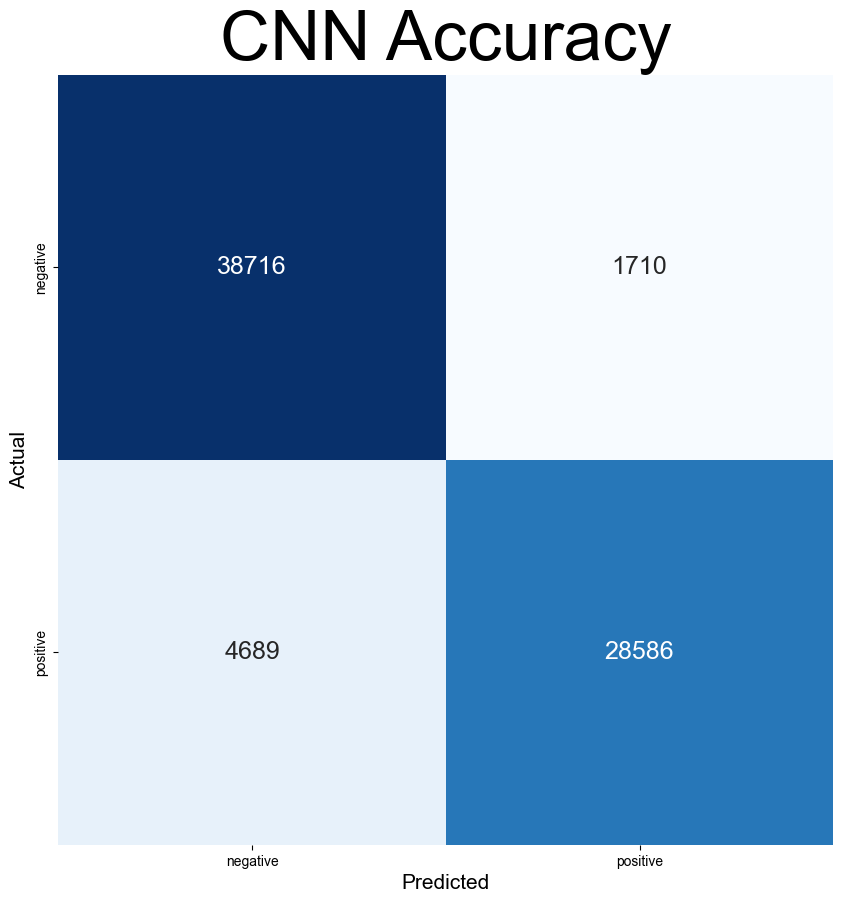

[[38716  1710]
 [ 4689 28586]]


In [29]:
from sklearn.metrics import accuracy_score, confusion_matrix
import seaborn as sns
classes = ['negative','positive']
cnn_accuracy = accuracy_score(Y_test.argmax(axis=-1),ypred2.argmax(axis=-1))
print("CNN Accuracy:",cnn_accuracy)
cnn_cn = confusion_matrix(Y_test.argmax(axis=-1),ypred2.argmax(axis=-1))
plt.subplots(figsize=(10,10))
sns.set(font_scale=1.5)
sns.heatmap(cnn_cn,annot=True,fmt="g", cmap='Blues',cbar=False,xticklabels=classes,yticklabels=classes)
plt.title("CNN Accuracy",fontsize=50)
plt.xlabel("Predicted",fontsize=15)
plt.ylabel("Actual",fontsize=15)
plt.show()
print(cnn_cn )

In [30]:
from sklearn.metrics import precision_score,recall_score, confusion_matrix, classification_report,accuracy_score, f1_score
print('\n Clasification report:\n', classification_report(Y_test.argmax(axis=-1),ypred2.argmax(axis=-1), digits=4))


 Clasification report:
               precision    recall  f1-score   support

           0     0.8920    0.9577    0.9237     40426
           1     0.9436    0.8591    0.8993     33275

    accuracy                         0.9132     73701
   macro avg     0.9178    0.9084    0.9115     73701
weighted avg     0.9153    0.9132    0.9127     73701



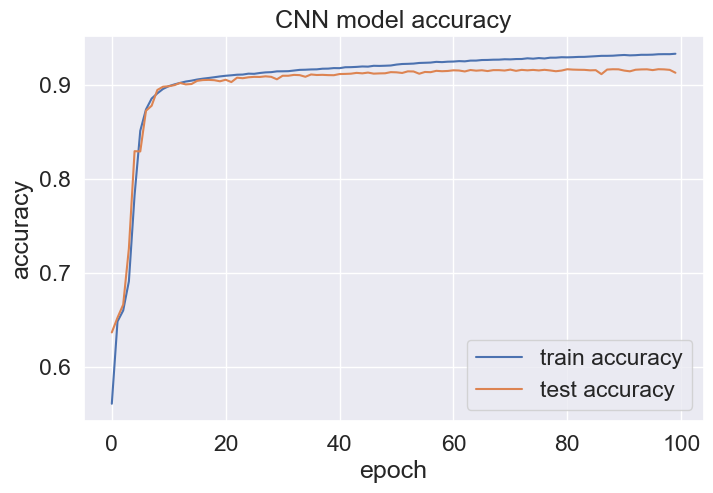

In [31]:
plt.figure(figsize=(8, 5))
ax = plt.axes()
ax.set_facecolor("#eaeaf2")
plt.plot(history.history['accuracy'],label="train accuracy")
plt.plot(history.history['val_accuracy'],label="test accuracy")
plt.title('CNN model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend()
plt.grid(color = 'w')
# plt.savefig('CNN_accuracy_CNN_relu-test',dpi=200); 
plt.show()


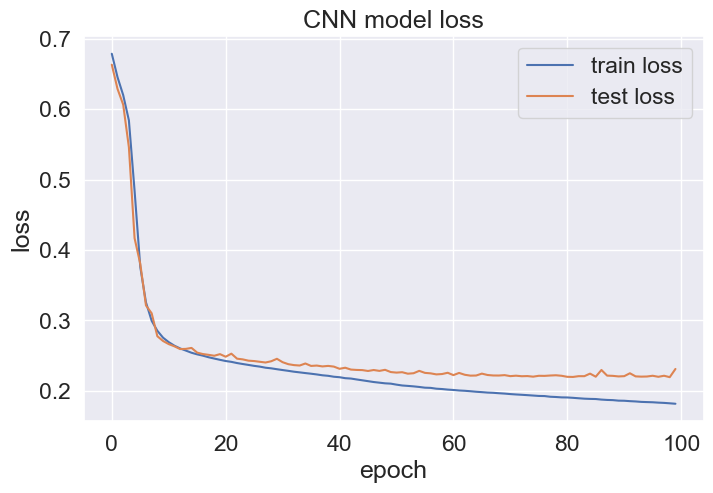

In [32]:
plt.figure(figsize=(8, 5))

ax = plt.axes()
ax.set_facecolor("#eaeaf2")
plt.plot(history.history['loss'],label="train loss")
plt.plot(history.history['val_loss'],label="test loss")
plt.title('CNN model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend()
plt.grid(color = 'w')
# plt.savefig('CNN_loss_CNN_relu-test',dpi=200); 
plt.show()

2304/2304 [==============================] - 10s 4ms/step


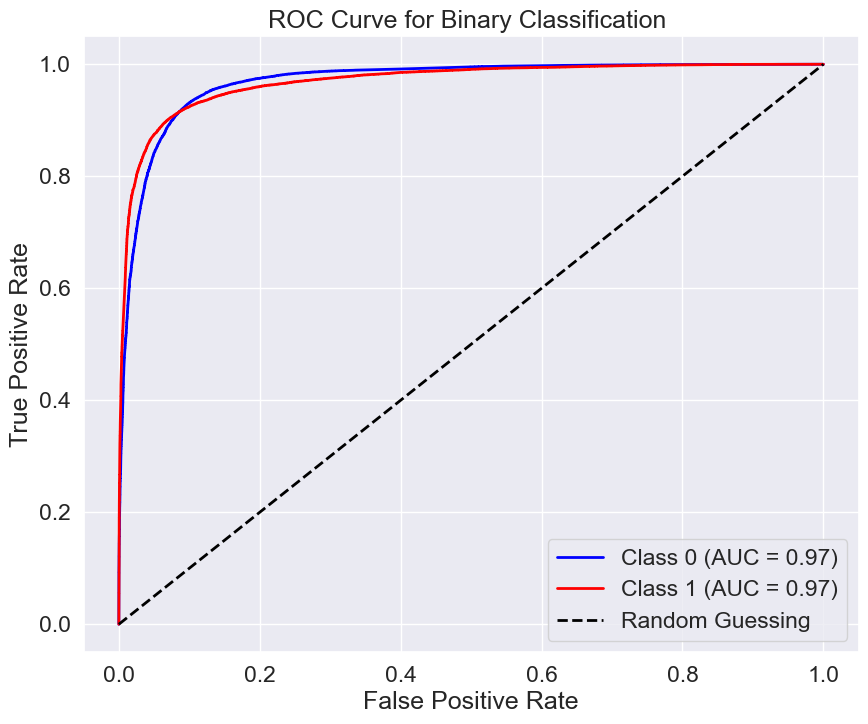

In [33]:
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_auc_score
from itertools import cycle


# Binarize the labels
# Assuming `y_test` contains the true labels for your test set
# Replace with your actual test labels
# y_test_bin = label_binarize(Y_test, classes=[1, 2, 3, 4, 5] )# Specify your class labels

y_true = Y_test  # Replace with your true labels
y_score = cnn_model.predict(X_test) # Replace with your predicted scores

y_true_binary = label_binarize(y_true, classes=[1, 3])

# Compute ROC curve and ROC area for each class
fpr = dict()
tpr = dict()
roc_auc = dict()

for i in range(2):
    fpr[i], tpr[i], _ = roc_curve(y_true_binary[:, i], y_score[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Plot ROC curve for each class
plt.figure(figsize=(10, 8))
colors = ['blue', 'red']  # Add more colors if you have more classes

for i, color in zip(range(2), colors):
    plt.plot(fpr[i], tpr[i], color=color, lw=2, label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

plt.plot([0, 1], [0, 1], color='black', lw=2, linestyle='--', label='Random Guessing')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Binary Classification ')
plt.legend(loc='lower right')
plt.show()

In [34]:
#test#